In [ ]:
# clone YOLOv5 repository
!git clone https://github.com/ultralytics/yolov5.git  # clone repo
%cd yolov5

# !git reset --hard 886f1c03d839575afecb059accf74296fad395b6

Cloning into 'yolov5'...
remote: Enumerating objects: 12928, done.
remote: Total 12928 (delta 0), reused 0 (delta 0), pack-reused 12928
Receiving objects: 100% (12928/12928), 11.86 MiB | 10.22 MiB/s, done.
Resolving deltas: 100% (8984/8984), done.
/content/yolov5


In [ ]:
# install wandb.ai
!pip install wandb
!wandb login 32da44c8b58cf4298af4bdc966f002d1c31c6bd1

# import wandb
# wandb.init(project="YOLOv5-Hard-Hat-Model", entity="a0-lee")

     |████████████████████████████████| 1.8 MB 33.4 MB/s 
     |████████████████████████████████| 144 kB 76.4 MB/s 
     |████████████████████████████████| 181 kB 64.3 MB/s 
     |████████████████████████████████| 63 kB 2.2 MB/s 
  Created wheel for pathtools: filename=pathtools-0.1.2-py3-none-any.whl size=8806 sha256=6ddf7365a134e4748016ea8d37cf36c96088010e95ad34ab839997ded6a84e08
  Stored in directory: /root/.cache/pip/wheels/3e/31/09/fa59cef12cdcfecc627b3d24273699f390e71828921b2cbba2
Successfully built pathtools
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
# install dependencies as necessary
!pip install -qr requirements.txt  # install dependencies (ignore errors)
import torch

from IPython.display import Image, clear_output  # to display images
from utils.downloads import gdrive_download  # to download models/datasets

# clear_output()
print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

     |████████████████████████████████| 596 kB 26.0 MB/s 
Setup complete. Using torch 1.10.0+cu111 _CudaDeviceProperties(name='Tesla T4', major=7, minor=5, total_memory=15109MB, multi_processor_count=40)


In [ ]:
#follow the link below to get your download code from from Roboflow
!pip install -q roboflow
from roboflow import Roboflow
rf = Roboflow(model_format="yolov5", notebook="roboflow-yolov5")

     |████████████████████████████████| 145 kB 40.8 MB/s 
     |████████████████████████████████| 178 kB 81.8 MB/s 
     |████████████████████████████████| 1.1 MB 85.7 MB/s 
     |████████████████████████████████| 67 kB 8.1 MB/s 
     |████████████████████████████████| 54 kB 3.3 MB/s 
     |████████████████████████████████| 138 kB 94.6 MB/s 
     |████████████████████████████████| 63 kB 2.0 MB/s 
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
google-colab 1.0.0 requires requests~=2.23.0, but you have requests 2.27.1 which is incompatible.
datascience 0.10.6 requires folium==0.2.1, but you have folium 0.8.3 which is incompatible.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.
upload and label your dataset, and get an API KEY here: https://app.roboflow.com/?model=yolov5&ref=roboflow-yolov5


In [ ]:
%cd /content/yolov5
#after following the link above, recieve python code with these fields filled in
from roboflow import Roboflow
rf = Roboflow(api_key="*ENTER KEY*")

print(rf.workspace().projects())
project = rf.project("hard-hat-sample-zxzls")
print(project.versions())
project = rf.workspace("andy-6cgyo").project("hard-hat-workers-fymiw")
dataset = project.version(1).download("yolov5")

/content/yolov5
loading Roboflow workspace...
['Hard Hat Sample', 'Hard Hat Workers']
[<roboflow.core.version.Version object at 0x7f8a8962e850>, <roboflow.core.version.Version object at 0x7f8a84f45b10>, <roboflow.core.version.Version object at 0x7f8b8d556f90>, <roboflow.core.version.Version object at 0x7f8a73d58590>, <roboflow.core.version.Version object at 0x7f8a84f62950>, <roboflow.core.version.Version object at 0x7f8a84f62490>, <roboflow.core.version.Version object at 0x7f8a84f626d0>, <roboflow.core.version.Version object at 0x7f8a84f62790>, <roboflow.core.version.Version object at 0x7f8a84f629d0>]
loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to Hard-Hat-Workers-1 in yolov5pytorch:: 100%|██████████| 35157/35157 [00:04<00:00, 7694.20it/s]


In [ ]:
# this is the YAML file Roboflow wrote for us that we're loading into this notebook with our data
%ls {dataset.location}/
%cat {dataset.location}/data.yaml

# define number of classes based on YAML
import yaml
with open(dataset.location + "/data.yaml", 'r') as stream:
    num_classes = str(yaml.safe_load(stream)['nc'])

data.yaml  README.roboflow.txt  test/  train/  valid/
names:
- head
- helmet
nc: 2
train: Hard-Hat-Workers-1/train/images
val: Hard-Hat-Workers-1/valid/images


In [ ]:
#this is the model configuration we will use for our tutorial 
%cat /content/yolov5/models/yolov5l.yaml

#customize iPython writefile so we can write variables
from IPython.core.magic import register_line_cell_magic

@register_line_cell_magic
def writetemplate(line, cell):
    with open(line, 'w') as f:
        f.write(cell.format(**globals()))

# YOLOv5 🚀 by Ultralytics, GPL-3.0 license

# Parameters
nc: 80  # number of classes
depth_multiple: 1.0  # model depth multiple
width_multiple: 1.0  # layer channel multiple
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 v6.0 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Conv, [64, 6, 2, 2]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 6, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 3, C3, [1024]],
   [-1, 1, SPPF, [1024, 5]],  # 9
  ]

# YOLOv5 v6.0 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]], 

In [ ]:
%%writetemplate /content/yolov5/models/custom_yolov5l.yaml

# Parameters
nc: {num_classes}  # number of classes
depth_multiple: 1.0  # model depth multiple
width_multiple: 1.0  # layer channel multiple
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 v6.0 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Conv, [64, 6, 2, 2]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 6, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 3, C3, [1024]],
   [-1, 1, SPPF, [1024, 5]],  # 9
  ]

# YOLOv5 v6.0 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, C3, [256, False]],  # 17 (P3/8-small)

   [-1, 1, Conv, [256, 3, 2]],
   [[-1, 14], 1, Concat, [1]],  # cat head P4
   [-1, 3, C3, [512, False]],  # 20 (P4/16-medium)

   [-1, 1, Conv, [512, 3, 2]],
   [[-1, 10], 1, Concat, [1]],  # cat head P5
   [-1, 3, C3, [1024, False]],  # 23 (P5/32-large)

   [[17, 20, 23], 1, Detect, [nc, anchors]],  # Detect(P3, P4, P5)
  ]

In [ ]:
# train yolov5s on custom data for x epochs
# time its performance
%%time
%cd /content/yolov5/
# --cache 
!python train.py --img 416 --batch 64 --epochs 100 --save-period 1 --data {dataset.location}/data.yaml --cfg ./models/custom_yolov5l.yaml --name yolov5l_results --weights ''

/content/yolov5
wandb: Currently logged in as: a0-lee (use `wandb login --relogin` to force relogin)
train: weights=, cfg=./models/custom_yolov5l.yaml, data=/content/yolov5/Hard-Hat-Workers-1/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=64, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=yolov5l_results, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-143-g6ea81bb torch 1.10.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_

In [ ]:
# OPTIONAL - resume wandb epoch training
%%time
%cd /content/yolov5/
run_path = "a0-lee/YOLOv5/3ph1m4b8"

!python train.py --resume wandb-artifact://{run_path}

/content/yolov5
wandb: Currently logged in as: a0-lee (use `wandb login --relogin` to force relogin)
train: weights=yolov5s.pt, cfg=, data=data/coco128.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=300, batch_size=16, imgsz=640, rect=False, resume=wandb-artifact://a0-lee/YOLOv5/3ph1m4b8, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-146-gb804b36 torch 1.10.0+cu111 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cl

In [ ]:
# OPTIONAL - save best weights from training for future inference
from google.colab import drive
drive.mount('/content/gdrive')

# %cp /content/yolov5/runs/train/yolov5s_results/weights/best.pt /content/gdrive/My\ Drive

# OPTIONAL - save best weights from wandb
%cp /content/yolov5/runs/train/exp/weights/last.pt /content/gdrive/My\ Drive

Mounted at /content/gdrive


In [ ]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

In [ ]:
# first, display our ground truth data
print("GROUND TRUTH TRAINING DATA:")
Image(filename='/content/yolov5/runs/train/yolov5s_results/test_batch0_labels.jpg', width=900)

In [ ]:
Image(filename='/content/yolov5/runs/train/exp/results.png', width=900)

In [ ]:
Image(filename='/content/yolov5/runs/train/yolov5s_results/train_batch0.jpg', width=900)

In [ ]:
# trained weights are saved by default in our weights folder
%ls runs/train/yolov5s_results/weights
# locate test images
%ls Hard-Hat-Workers-1/test/images

# locate and use the best weights!
%cd /content/yolov5/
%ls /content/yolov5/weights

# # use recently trained weights for test images
# !python detect.py --weights runs/train/yolov5s_results/weights/best.pt --img 416 --conf 0.4 --source Hard-Hat-Sample-5/test/images

!python detect.py --weights runs/train/exp/weights/last.pt --img 416 --conf 0.6 --source Hard-Hat-Workers-1/test/images

# or use existing weights from google drive for test images
# from google.colab import drive
# drive.mount('/content/gdrive')
# %cp /content/gdrive/My\ Drive/last.pt /content/yolov5/weights
# %ls /content/yolov5/weights
# !python detect.py --weights /content/yolov5/weights/last.pt --img 416 --conf 0.6 --source Hard-Hat-Sample-12/test/images

ls: cannot access 'runs/train/yolov5s_results/weights': No such file or directory
005298_jpg.rf.54c35b042fabf15d345b1e15b89120be.jpg
005299_jpg.rf.6aaf15ff5bdc9a39844e4b70922c84a1.jpg
005300_jpg.rf.b52aab2f50f773bdf4c35965682a1428.jpg
005301_jpg.rf.2174453b7fb5ec8f96b2782bebe9be69.jpg
005302_jpg.rf.4c4227046c4a5421763f39a83fbf7154.jpg
005303_jpg.rf.80a0cd67f24d17877bfe964ecfa1a691.jpg
005304_jpg.rf.05ed5140bf2362fc859e45e906b4c349.jpg
005305_jpg.rf.3bd7ae9d6410d4c5362184fbc75872a5.jpg
005306_jpg.rf.e2ea551df2db74f0763bf5f91ae95958.jpg
005307_jpg.rf.429c851fc1843bf22e1e63bd3c48d4bd.jpg
005308_jpg.rf.baecf7d64be2c317010c7aca96ddbbfc.jpg
005309_jpg.rf.a4618d079b0e325e2998afa14cf78a8c.jpg
005310_jpg.rf.8cdd396c168bbcccb8191296991c77bf.jpg
005311_jpg.rf.427bccfdb6c5b51fbb000c227cb5f3ec.jpg
005312_jpg.rf.8d29cb93c1795538ef2d6f00fde73681.jpg
005313_jpg.rf.e9d54254d65e1f282d0478041f254fc1.jpg
005314_jpg.rf.7d088159bafbd7babffccc7f936d7dab.jpg
005315_jpg.rf.0cc3395f24ed24ab1769fbb753ac4c0a.jpg


In [ ]:
# every train and test run increments runs/detect/exp and runs/trains/yolov5_results
%ls runs/detect
%ls runs/train

exp/
exp/


Populating the interactive namespace from numpy and matplotlib


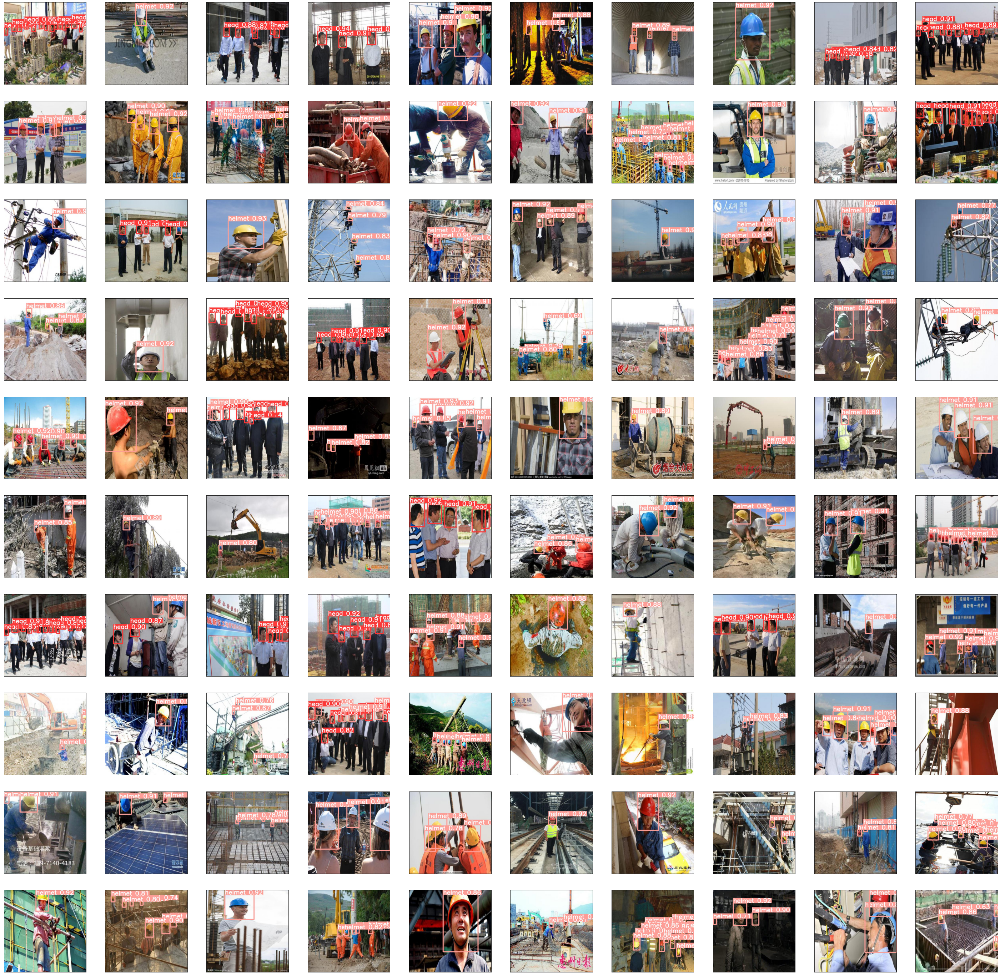

In [ ]:
#display inference on ALL test images
#this looks much better with longer training above

import glob
from IPython.display import Image, display
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%pylab inline

# for imageName in glob.glob('/content/yolov5/runs/detect/exp/*.jpg'): #assuming JPG
#     display(Image(filename=imageName))
#     print("\n")

imageArr = glob.glob('/content/yolov5/runs/detect/exp/*.jpg')

plt.figure(figsize=(50,50))
for i in range(100):
  plt.subplot(10, 10, i + 1)
  plt.xticks([])
  plt.yticks([])
  plt.grid(False)
  img = mpimg.imread(imageArr[i])
  plt.imshow(img)
plt.show()

In [ ]:
import os
from IPython.display import YouTubeVideo
video = YouTubeVideo("Dhxf5mm7g1g", start=10)
display(video)

%ls /content/yolov5/Hard-Hat-Workers-1/test
%cd /content/yolov5/Hard-Hat-Workers-1/test

dirName = 'videos'

if not os.path.exists(dirName):
    os.mkdir(dirName)
    print("Directory " , dirName ,  " Created ")
else:    
    print("Directory " , dirName ,  " already exists")

!pip install pytube
from pytube import YouTube
# download YT video as mp4 file
yt = YouTube('https://www.youtube.com/watch?v=Dhxf5mm7g1g')
yt.streams.filter(progressive=True, file_extension='mp4').first().download('/content/yolov5/Hard-Hat-Workers-1/test/videos', filename='video1.mp4')

In [ ]:
%cd /content/yolov5/
# test real-time object detection on downloaded YouTube video
# /content/yolov5/weights/last.pt
!python detect.py --weights runs/train/yolov5s_results/weights/best.pt --conf 0.6 --source Hard-Hat-Workers-1/test/videos/video1.mp4